In [1]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'  # or any {'0', '1', '2'}
# 0: infos, warning, errors.
# 1: warnings, errors.
# 2: errors.
# 3: none.
import tensorflow as tf
physical_devices = tf.config.list_physical_devices('GPU')
print("GPUs available:", physical_devices)
tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)

GPUs available: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [2]:
from functools import partial
import math
import numpy as np
import random

from ocml.datasets import build_ds, tfds_from_sampler, tf_from_tfds, zip_ds, preprocess_cifar10
from ocml.evaluate import check_LLC, log_metrics
from ocml.models import spectral_VGG, spectral_VGG_V2
from ocml.plot import plot_preds_ood, plot_imgs_grid, plot_gan
from ocml.priors import uniform_image, augment_cifar10, Cifar10_NDA
from ocml.train import train, SH_KR

Perlin noise not available. Please install perlin_numpy package with `pip3 install git+https://github.com/pvigier/perlin-numpy`.


In [3]:
from types import SimpleNamespace
import math


def perc_to_margin(img_size, num_channels, perc, domain):
    return perc * (img_size * img_size * num_channels * (domain[1] - domain[0]))**0.5

def get_config(debug=False):
  domain = [-2, 2.]  # required for images.
  # heuristic of https://arxiv.org/abs/2206.06854
  ratio_images = 0.1 / 100
  ratio_pixels = 1 / 100
  margin = perc_to_margin(32, 3, ratio_pixels, domain)
  lbda = 1. / ratio_images  
  print(f"Margin={margin:.3f} Lambda={lbda:.3f}")
  dataset_name = os.environ.get("DATASET_NAME", "cifar10")
  config = SimpleNamespace(
    dataset_name = dataset_name,
    # Newton-Raphson.
    maxiter = 32,
    eta = 10.,
    level_set = -margin,
    batch_size = 128,
    domain = domain,
    margin = margin,
    lbda = lbda,
    domain_clip = True,
    deterministic = False,
    negative_augmentation = False,
    overshoot_boundary = True,
    # architecture.
    k_coef_lip = 1.,
    strides = False,
    spectral_dense = True,
    pooling = True,
    global_pooling = False,
    groupsort = True,
    conv_widths = [256, 256, 256],
    dense_widths = [256, 256, 256],
    # training.
    in_labels = [9],
    warmup_epochs = 10,
    epochs_per_plot = 40,
  )
  return config

In [4]:
debug = "SANDBOX" in os.environ
config = get_config(debug)
train_kwargs = {
  'domain': config.domain,
  'eta': config.eta,
  'deterministic': config.deterministic,
  'level_set': config.level_set,
  'overshoot_boundary': config.overshoot_boundary
}

Margin=1.109 Lambda=1000.000


In [5]:
import plotly.io as pio
print("PLOTLY_RENDERER:", pio.renderers.default)
try:
  import wandb
  wandb.login()
  wandb_available = True
except ModuleNotFoundError as e:
  print(e)
  print("Wandb logs will be removed.")
  wandb_available = False
plot_wandb = wandb_available and not debug  # Set to False to de-activate Wandb.
if plot_wandb:
  import wandb
  group = os.environ.get("WANDB_GROUP", "sandbox_cifar10")
  wandb.init(project="ocml_cifar10", config=config.__dict__, group=group, save_code=True)
else:
  try:
    wandb.finish()
  except Exception as e:
    print(e)

train_kwargs['log_metrics_fn'] = partial(log_metrics, plot_wandb=plot_wandb)

PLOTLY_RENDERER: plotly_mimetype+notebook


Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: algue (use `wandb login --relogin` to force relogin)
wandb: wandb version 0.13.5 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


In [6]:
input_shape = (32, 32, 3)
V2 = True
if V2:
  model = spectral_VGG_V2(input_shape, k_coef_lip=config.k_coef_lip, scale=1)
else:
  model = spectral_VGG(input_shape, conv_widths=config.conv_widths,
                       dense_widths=config.dense_widths,
                       k_coef_lip=config.k_coef_lip,
                       groupsort=config.groupsort,
                       pooling=config.pooling,
                       global_pooling=config.global_pooling)

loss_fn = SH_KR(config.margin, config.lbda)

In [7]:
build_ds = partial(build_ds, preprocess_fun=preprocess_cifar10)

In [8]:
# Produce and process dataset.
p_dataset = build_ds(config.dataset_name, config.batch_size, in_labels=config.in_labels, domain=config.domain)
num_images = 50 * 1000
epoch_length = math.ceil(num_images*len(config.in_labels)*(1/10) / config.batch_size) if not debug else 3

In [9]:
X_P = tf.reshape(tf_from_tfds(p_dataset.take(epoch_length)), shape=(-1,)+input_shape)
p_dataset = augment_cifar10(p_dataset)
X_test = tf_from_tfds(build_ds(config.dataset_name, config.batch_size, in_labels=config.in_labels, domain=config.domain, split='test'))
X_ood = tf_from_tfds(build_ds(config.dataset_name, config.batch_size, in_labels=config.in_labels, domain=config.domain, split='ood'))
print(f'TrainSize={len(X_P)} TestSize={len(X_test)} OODSize={len(X_ood)}')

TrainSize=5120 TestSize=1000 OODSize=9000


In [10]:
# Create optimizer class.
blocks = 4
decay_steps = epoch_length*(config.warmup_epochs + config.epochs_per_plot*blocks)
initial_learning_rate = 1e-3
learning_rate =  tf.keras.optimizers.schedules.PolynomialDecay(
    initial_learning_rate=initial_learning_rate, decay_steps=decay_steps,
  end_learning_rate=initial_learning_rate/1000, power=1.)
opt = tf.keras.optimizers.RMSprop(learning_rate=learning_rate)

# Initialize the network.
gen = tf.random.Generator.from_seed(random.randint(0, 1000))
p_batch = next(iter(p_dataset))
_ = model(p_batch, training=True)  # garbage forward.
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
spectral_conv2d (SpectralCon (128, 32, 32, 64)         3585      
_________________________________________________________________
group_sort2 (GroupSort2)     (128, 32, 32, 64)         0         
_________________________________________________________________
spectral_conv2d_1 (SpectralC (128, 32, 32, 64)         73857     
_________________________________________________________________
group_sort2_1 (GroupSort2)   (128, 32, 32, 64)         0         
_________________________________________________________________
spectral_conv2d_2 (SpectralC (128, 32, 32, 64)         73857     
_________________________________________________________________
group_sort2_2 (GroupSort2)   (128, 32, 32, 64)         0         
_________________________________________________________________
spectral_conv2d_3 (SpectralC (128, 32, 32, 64)         7

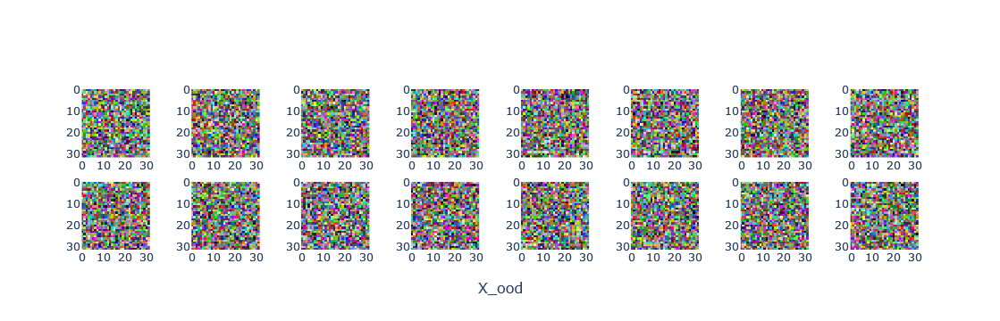

In [11]:
# Adversarial distribution.
if config.negative_augmentation:
  bs_1, bs_2 = config.batch_size // 2, config.batch_size - (config.batch_size // 2)
  q_random = tfds_from_sampler(uniform_image, gen, bs_1, p_batch.shape[1:], domain=config.domain)
  q_nda = Cifar10_NDA(bs_1, p_batch.shape[1:]).transform(gen, build_mnist(config.dataset_name, bs_2, in_labels=config.in_labels))
  q_dataset = zip_ds(q_random, q_nda)
else:
  q_dataset = tfds_from_sampler(uniform_image, gen, config.batch_size, p_batch.shape[1:], domain=config.domain)
Q0 = next(iter(q_dataset))
plot_imgs_grid(Q0, 'X_ood.png')

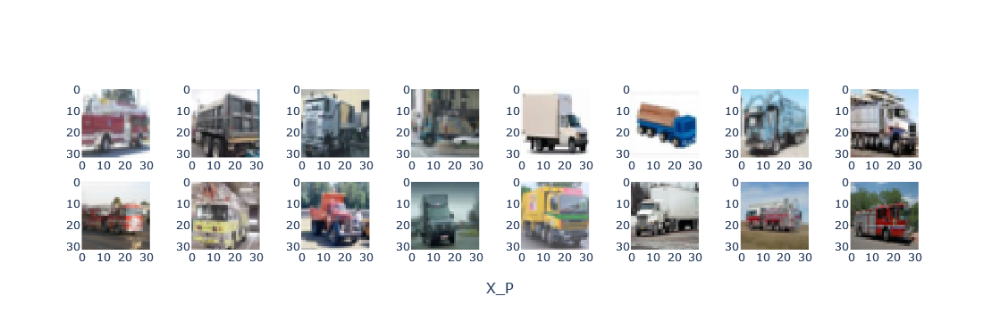

In [12]:
# plot_imgs_grid(X_test, 'X_test.png')
# plot_imgs_grid(X_ood, 'X_ood.png')
# check_LLC(model, Q0, plot_wandb)
plot_imgs_grid(X_P, 'X_P.png')

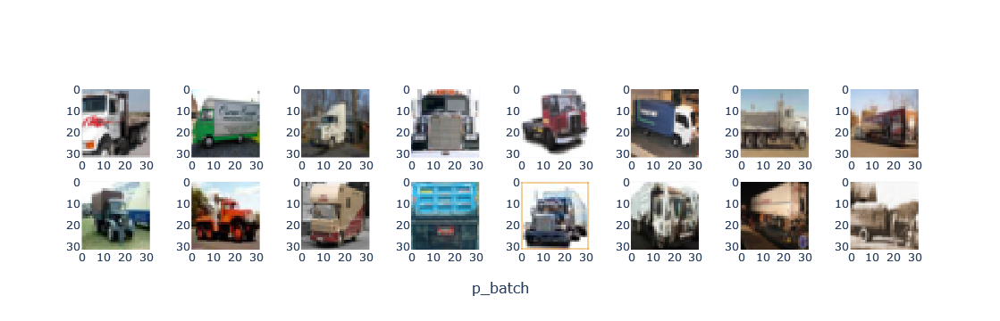

In [13]:
plot_imgs_grid(p_batch, 'p_batch.png')

Epoch=0 LR=0.0010000


100%|██████████| 40/40 [01:21<00:00,  2.05s/it, FP=0.00%, GN_Qt=0.000, P=1.680, Q0=-1.853, Qt=-1.853, R=1.00%, lipschitz_ratio=1.000, loss=1.265] 


Epoch=1 LR=0.0009941


100%|██████████| 40/40 [00:08<00:00,  4.77it/s, FP=0.00%, GN_Qt=0.000, P=3.856, Q0=-4.670, Qt=-4.670, R=1.00%, lipschitz_ratio=1.000, loss=-0.005]


Epoch=2 LR=0.0009882


100%|██████████| 40/40 [00:08<00:00,  4.50it/s, FP=0.00%, GN_Qt=0.000, P=4.092, Q0=-3.775, Qt=-3.775, R=1.00%, lipschitz_ratio=1.000, loss=0.171]


Epoch=3 LR=0.0009824


100%|██████████| 40/40 [00:08<00:00,  4.51it/s, FP=0.00%, GN_Qt=0.000, P=15.121, Q0=-5.932, Qt=-5.932, R=1.00%, lipschitz_ratio=1.000, loss=-0.014] 


Epoch=4 LR=0.0009765


100%|██████████| 40/40 [00:09<00:00,  4.22it/s, FP=0.00%, GN_Qt=0.000, P=2.456, Q0=-4.925, Qt=-4.925, R=1.00%, lipschitz_ratio=1.000, loss=0.415]    


Epoch=5 LR=0.0009706


100%|██████████| 40/40 [00:08<00:00,  4.47it/s, FP=0.00%, GN_Qt=0.000, P=4.746, Q0=-10.193, Qt=-10.193, R=1.00%, lipschitz_ratio=1.000, loss=-0.010]


Epoch=6 LR=0.0009647


100%|██████████| 40/40 [00:09<00:00,  4.37it/s, FP=0.00%, GN_Qt=0.000, P=15.523, Q0=-18.728, Qt=-18.728, R=1.00%, lipschitz_ratio=1.000, loss=-0.026]


Epoch=7 LR=0.0009589


100%|██████████| 40/40 [00:09<00:00,  4.08it/s, FP=0.00%, GN_Qt=0.000, P=15.358, Q0=-25.578, Qt=-25.578, R=1.00%, lipschitz_ratio=1.000, loss=-0.037]


Epoch=8 LR=0.0009530


100%|██████████| 40/40 [00:09<00:00,  4.34it/s, FP=0.00%, GN_Qt=0.000, P=19.190, Q0=-10.542, Qt=-10.542, R=1.00%, lipschitz_ratio=1.000, loss=0.742]


Epoch=9 LR=0.0009471


100%|██████████| 40/40 [00:09<00:00,  4.26it/s, FP=0.00%, GN_Qt=0.000, P=29.834, Q0=-12.824, Qt=-12.824, R=1.00%, lipschitz_ratio=1.000, loss=-0.038]


36/36 [==============================] - 20s 576ms/step
Train examples DescribeResult(nobs=5120, minmax=(9.2553625, 59.447468), mean=28.67727, variance=57.410706, skewness=0.453535795211792, kurtosis=0.1788793584222952)
Test examples DescribeResult(nobs=1000, minmax=(8.727795, 65.537346), mean=28.500834, variance=54.756554, skewness=0.570563018321991, kurtosis=0.9973698290800179)
OOD examples DescribeResult(nobs=9000, minmax=(-0.14100714, 81.53148), mean=26.542816, variance=95.39311, skewness=0.6556597352027893, kurtosis=0.7110328391882472)
[train/ood] Avg Dist=2.134 T=81.531 Acc=63.74%
[train/ood] AUROC =58.383
[test /ood] Avg Dist =1.958017349243164 T=81.531 Acc=90.00%
[test /ood] AUROC =58.040


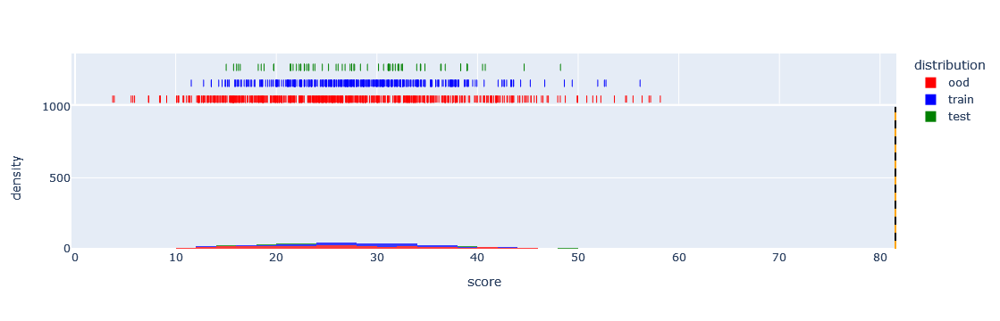

1/1 [==============================] - 0s 25ms/step
P=28.42432403564453 y_Q0=-15.046052932739258  y_Qt=-1.107586145401001 y_Qinf=28.081666946411133


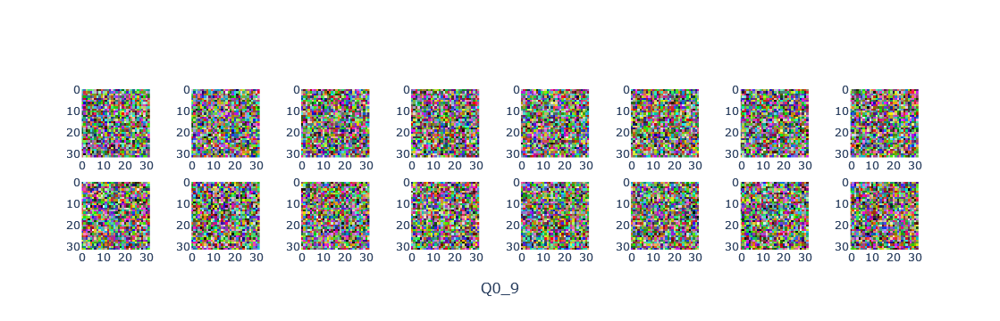

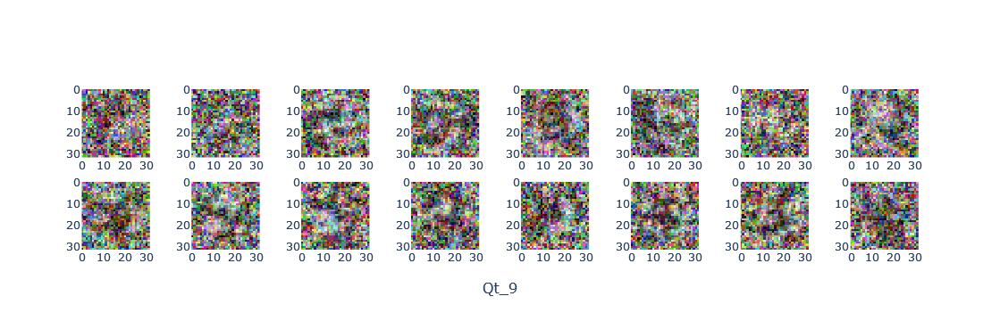

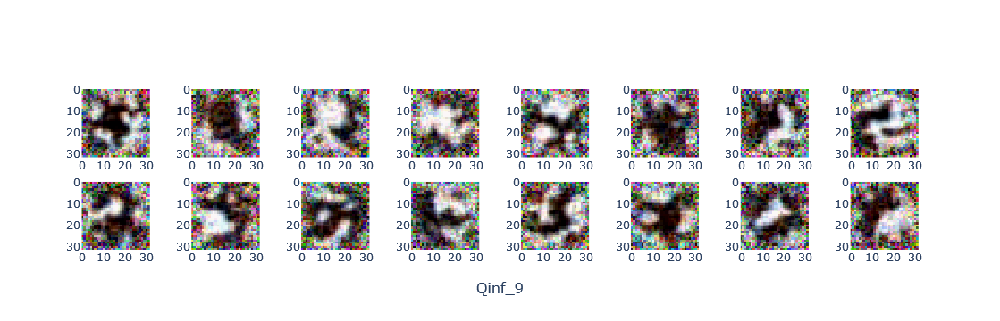

In [14]:
epoch = 0
for epoch in range(0, config.warmup_epochs):
  print(f"Epoch={epoch} LR={float(opt._decayed_lr(tf.float32)):.7f}")
  train(model, opt, loss_fn, gen, p_dataset, q_dataset, epoch_length, maxiter=0, **train_kwargs)
plot_preds_ood(epoch, model, X_P, X_test, X_ood, plot_histogram=True, plot_wandb=plot_wandb)
plot_gan(epoch, model, p_batch, Q0[:16], gen, maxiter=config.maxiter, **train_kwargs)

In [ ]:
end_epoch = config.epochs_per_plot+epoch+1
for epoch in range(epoch+1, end_epoch):
  print(f"Epoch={epoch} LR={float(opt._decayed_lr(tf.float32)):.7f}")
  train(model, opt, loss_fn, gen, p_dataset, q_dataset, epoch_length, maxiter=config.maxiter, **train_kwargs)
  plot_histogram = (epoch+1 == end_epoch)
  plot_preds_ood(epoch, model, X_P, X_test, X_ood, plot_histogram=plot_histogram, plot_wandb=plot_wandb)
plot_gan(epoch, model, p_batch, Q0[:16], gen, maxiter=config.maxiter, **train_kwargs)

Epoch=10 LR=0.0009412


100%|██████████| 40/40 [01:24<00:00,  2.11s/it, FP=0.03%, GN_Qt=0.031, P=-0.126, Q0=-4.811, Qt=-0.236, R=0.32%, lipschitz_ratio=3.635, loss=2.442] 


36/36 [==============================] - 1s 24ms/step
Train examples DescribeResult(nobs=5120, minmax=(-0.4061928, 2.4458632), mean=0.22910233, variance=0.1529105, skewness=1.7175675630569458, kurtosis=3.2785197626550096)
Test examples DescribeResult(nobs=1000, minmax=(-0.3900938, 3.015089), mean=0.24278225, variance=0.15875572, skewness=1.7555792331695557, kurtosis=4.236125833498992)
OOD examples DescribeResult(nobs=9000, minmax=(-0.5515905, 3.8250828), mean=0.15091096, variance=0.18312503, skewness=2.605766534805298, kurtosis=8.175624404104177)
[train/ood] Avg Dist=0.078 T=3.825 Acc=63.74%
[train/ood] AUROC =60.563
[test /ood] Avg Dist =0.09187129139900208 T=3.825 Acc=90.00%
[test /ood] AUROC =61.107
Epoch=11 LR=0.0009354


100%|██████████| 40/40 [00:41<00:00,  1.03s/it, FP=0.08%, GN_Qt=0.069, P=-0.067, Q0=-9.168, Qt=-0.345, R=0.40%, lipschitz_ratio=2.641, loss=2.091] 

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 1s 24ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.4821457, 2.6720488), mean=0.015250878, variance=0.39330482, skewness=0.7046458125114441, kurtosis=0.4800084335034187)
Test examples DescribeResult(nobs=1000, minmax=(-1.7164117, 3.3824766), mean=0.013014951, variance=0.3944058, skewness=0.7620105743408203, kurtosis=0.8512462314614848)
OOD examples DescribeResult(nobs=9000, minmax=(-2.0194607, 4.1873817), mean=-0.17785688, variance=0.4855564, skewness=1.0800118446350098, kurtosis=1.9433544511638656)
[train/ood] Avg Dist=0.193 T=4.187 Acc=63.74%
[train/ood] AUROC =59.955
[test /ood] Avg Dist =0.19087183475494385 T=4.187 Acc=90.00%
[test /ood] AUROC =59.761
Epoch=12 LR=0.0009295


100%|██████████| 40/40 [00:41<00:00,  1.05s/it, FP=0.23%, GN_Qt=0.066, P=0.765, Q0=-5.369, Qt=-0.249, R=0.66%, lipschitz_ratio=3.315, loss=2.042] 


36/36 [==============================] - 1s 24ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.9032693, 3.5280356), mean=-0.55613196, variance=0.58608174, skewness=1.420381784439087, kurtosis=2.3664256630376226)
Test examples DescribeResult(nobs=1000, minmax=(-2.0488694, 4.4932203), mean=-0.5469592, variance=0.5949034, skewness=1.4274438619613647, kurtosis=2.9381318265391245)
OOD examples DescribeResult(nobs=9000, minmax=(-2.1908693, 5.8793907), mean=-0.7798045, variance=0.6533026, skewness=2.17032790184021, kurtosis=6.6158660318805556)
[train/ood] Avg Dist=0.224 T=5.879 Acc=63.74%
[train/ood] AUROC =61.531
[test /ood] Avg Dist =0.23284530639648438 T=5.879 Acc=90.00%
[test /ood] AUROC =61.579
Epoch=13 LR=0.0009236


100%|██████████| 40/40 [00:41<00:00,  1.04s/it, FP=0.18%, GN_Qt=0.027, P=0.156, Q0=-5.884, Qt=-0.211, R=0.65%, lipschitz_ratio=3.188, loss=2.095] 


36/36 [==============================] - 1s 24ms/step
Train examples DescribeResult(nobs=5120, minmax=(-0.68110317, 3.472554), mean=0.6250257, variance=0.3609666, skewness=1.1346931457519531, kurtosis=1.2265468182819799)
Test examples DescribeResult(nobs=1000, minmax=(-0.7165224, 3.9819026), mean=0.63921106, variance=0.3728537, skewness=1.0741928815841675, kurtosis=1.2575574862705263)
OOD examples DescribeResult(nobs=9000, minmax=(-0.8203636, 4.7263336), mean=0.43080422, variance=0.38257164, skewness=1.8670694828033447, kurtosis=4.4220631899002445)
[train/ood] Avg Dist=0.194 T=4.726 Acc=63.74%
[train/ood] AUROC =62.006
[test /ood] Avg Dist =0.20840683579444885 T=4.726 Acc=90.00%
[test /ood] AUROC =62.100
Epoch=14 LR=0.0009177


100%|██████████| 40/40 [00:41<00:00,  1.05s/it, FP=0.05%, GN_Qt=0.028, P=-0.117, Q0=-6.642, Qt=-0.185, R=0.33%, lipschitz_ratio=3.332, loss=2.102]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 1s 24ms/step
Train examples DescribeResult(nobs=5120, minmax=(-0.7797084, 2.2797427), mean=0.066119686, variance=0.18415281, skewness=1.4674774408340454, kurtosis=2.075793050074635)
Test examples DescribeResult(nobs=1000, minmax=(-0.69954234, 2.5072641), mean=0.07874566, variance=0.18890317, skewness=1.334679365158081, kurtosis=1.749630744427658)
OOD examples DescribeResult(nobs=9000, minmax=(-0.85027134, 3.1132128), mean=-0.09211211, variance=0.16926162, skewness=2.488025188446045, kurtosis=7.37667763759227)
[train/ood] Avg Dist=0.158 T=0.043 Acc=65.38%
[train/ood] AUROC =65.203
[test /ood] Avg Dist =0.170857772231102 T=3.113 Acc=90.00%
[test /ood] AUROC =65.126
Epoch=15 LR=0.0009119


100%|██████████| 40/40 [00:41<00:00,  1.04s/it, FP=0.06%, GN_Qt=0.034, P=0.302, Q0=-4.323, Qt=-0.188, R=0.52%, lipschitz_ratio=3.832, loss=2.065] 

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 1s 24ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.0724001, 4.292533), mean=-0.0076710046, variance=0.59553313, skewness=1.6569093465805054, kurtosis=2.7644171489078078)
Test examples DescribeResult(nobs=1000, minmax=(-0.96632475, 4.9381723), mean=0.017685689, variance=0.6100868, skewness=1.5562090873718262, kurtosis=2.7793762633250525)
OOD examples DescribeResult(nobs=9000, minmax=(-1.030877, 6.21217), mean=-0.25524274, variance=0.5888408, skewness=2.7165164947509766, kurtosis=8.51313523405665)
[train/ood] Avg Dist=0.248 T=-0.269 Acc=64.79%
[train/ood] AUROC =65.629
[test /ood] Avg Dist =0.2729284167289734 T=6.212 Acc=90.00%
[test /ood] AUROC =65.697
Epoch=16 LR=0.0009060


100%|██████████| 40/40 [00:41<00:00,  1.04s/it, FP=0.11%, GN_Qt=0.016, P=0.049, Q0=-3.107, Qt=-0.144, R=0.83%, lipschitz_ratio=4.065, loss=2.088] 

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 1s 24ms/step
Train examples DescribeResult(nobs=5120, minmax=(-0.49724108, 0.3049428), mean=0.09780617, variance=0.0071245497, skewness=-0.4866097867488861, kurtosis=0.46329001100390954)
Test examples DescribeResult(nobs=1000, minmax=(-0.3457471, 0.27281332), mean=0.09812086, variance=0.007168754, skewness=-0.4510302245616913, kurtosis=0.22634615216533893)
OOD examples DescribeResult(nobs=9000, minmax=(-0.40107194, 0.3075295), mean=0.05907683, variance=0.009421901, skewness=-0.1814618557691574, kurtosis=0.016784292126645894)
[train/ood] Avg Dist=0.039 T=0.304 Acc=63.74%
[train/ood] AUROC =62.182
[test /ood] Avg Dist =0.039044030010700226 T=0.308 Acc=90.00%
[test /ood] AUROC =62.134
Epoch=17 LR=0.0009001


100%|██████████| 40/40 [00:41<00:00,  1.04s/it, FP=0.00%, GN_Qt=0.014, P=-0.311, Q0=-4.145, Qt=-0.133, R=0.02%, lipschitz_ratio=4.147, loss=2.053]


36/36 [==============================] - 1s 23ms/step
Train examples DescribeResult(nobs=5120, minmax=(-0.36101595, 0.44812742), mean=0.07817387, variance=0.009842944, skewness=0.62431800365448, kurtosis=0.16489714164192026)
Test examples DescribeResult(nobs=1000, minmax=(-0.27340236, 0.39374524), mean=0.080081105, variance=0.009946995, skewness=0.392916202545166, kurtosis=-0.20114951466340347)
OOD examples DescribeResult(nobs=9000, minmax=(-0.38879392, 0.46518376), mean=0.008566468, variance=0.008168067, skewness=1.0863436460494995, kurtosis=1.9826691033686226)
[train/ood] Avg Dist=0.070 T=0.091 Acc=67.81%
[train/ood] AUROC =71.698
[test /ood] Avg Dist =0.07151463627815247 T=0.465 Acc=90.00%
[test /ood] AUROC =71.961
Epoch=18 LR=0.0008942


100%|██████████| 40/40 [00:41<00:00,  1.05s/it, FP=0.08%, GN_Qt=0.033, P=-0.000, Q0=-4.920, Qt=-0.215, R=0.37%, lipschitz_ratio=3.715, loss=2.052] 

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 1s 24ms/step
Train examples DescribeResult(nobs=5120, minmax=(-0.9008019, 2.5455635), mean=-0.03720662, variance=0.22545291, skewness=1.7114458084106445, kurtosis=3.298308594710438)
Test examples DescribeResult(nobs=1000, minmax=(-0.7816997, 2.7039683), mean=-0.025827453, variance=0.22607107, skewness=1.5415329933166504, kurtosis=2.8033151690251517)
OOD examples DescribeResult(nobs=9000, minmax=(-0.88204753, 3.4827838), mean=-0.21826106, variance=0.21491921, skewness=2.575314998626709, kurtosis=8.207090191191124)
[train/ood] Avg Dist=0.181 T=-0.066 Acc=64.94%
[train/ood] AUROC =66.430
[test /ood] Avg Dist =0.19243361055850983 T=3.483 Acc=90.00%
[test /ood] AUROC =66.490
Epoch=19 LR=0.0008883


100%|██████████| 40/40 [00:41<00:00,  1.05s/it, FP=0.12%, GN_Qt=0.024, P=0.360, Q0=-4.839, Qt=-0.198, R=0.78%, lipschitz_ratio=3.488, loss=2.047] 


36/36 [==============================] - 1s 24ms/step
Train examples DescribeResult(nobs=5120, minmax=(-0.78943527, 4.7591505), mean=0.54583853, variance=0.69914013, skewness=1.4686055183410645, kurtosis=1.9656675989084462)
Test examples DescribeResult(nobs=1000, minmax=(-0.7678879, 5.229685), mean=0.57137614, variance=0.7193457, skewness=1.3326596021652222, kurtosis=1.6610448741920507)
OOD examples DescribeResult(nobs=9000, minmax=(-0.8138435, 6.2665486), mean=0.21765122, variance=0.6692807, skewness=2.394043445587158, kurtosis=6.450867404825978)
[train/ood] Avg Dist=0.328 T=0.326 Acc=65.43%
[train/ood] AUROC =67.100
[test /ood] Avg Dist =0.3537249267101288 T=6.267 Acc=90.00%
[test /ood] AUROC =67.047
Epoch=20 LR=0.0008825


100%|██████████| 40/40 [00:41<00:00,  1.04s/it, FP=0.07%, GN_Qt=0.070, P=-0.197, Q0=-7.235, Qt=-0.397, R=0.34%, lipschitz_ratio=3.092, loss=2.072]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 1s 23ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.3144932, 0.9022441), mean=-0.37623152, variance=0.07655548, skewness=0.8820528388023376, kurtosis=1.3806263970431196)
Test examples DescribeResult(nobs=1000, minmax=(-1.2609091, 0.81144977), mean=-0.37342125, variance=0.07431456, skewness=0.7435725927352905, kurtosis=0.8737926040355202)
OOD examples DescribeResult(nobs=9000, minmax=(-1.3489921, 1.1108574), mean=-0.5261023, variance=0.07651369, skewness=1.1085370779037476, kurtosis=2.742787127466431)
[train/ood] Avg Dist=0.150 T=-0.212 Acc=65.52%
[train/ood] AUROC =66.673
[test /ood] Avg Dist =0.15268105268478394 T=1.111 Acc=90.00%
[test /ood] AUROC =66.907
Epoch=21 LR=0.0008766


100%|██████████| 40/40 [00:41<00:00,  1.04s/it, FP=0.01%, GN_Qt=0.023, P=-0.203, Q0=-4.800, Qt=-0.352, R=0.18%, lipschitz_ratio=3.870, loss=2.060]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 1s 24ms/step
Train examples DescribeResult(nobs=5120, minmax=(-0.37053353, 2.2423584), mean=0.21547267, variance=0.13898721, skewness=1.9782339334487915, kurtosis=3.9947141023910024)
Test examples DescribeResult(nobs=1000, minmax=(-0.24606164, 2.0711768), mean=0.22730689, variance=0.13818334, skewness=1.762352466583252, kurtosis=3.0193181384555823)
OOD examples DescribeResult(nobs=9000, minmax=(-0.37652105, 2.7924492), mean=0.08166344, variance=0.11369386, skewness=3.0439822673797607, kurtosis=10.460294949889349)
[train/ood] Avg Dist=0.134 T=0.111 Acc=65.71%
[train/ood] AUROC =68.852
[test /ood] Avg Dist =0.1456434428691864 T=2.792 Acc=90.00%
[test /ood] AUROC =69.166
Epoch=22 LR=0.0008707


100%|██████████| 40/40 [00:41<00:00,  1.04s/it, FP=0.08%, GN_Qt=0.029, P=0.264, Q0=-5.384, Qt=-0.277, R=0.53%, lipschitz_ratio=3.546, loss=2.029] 


36/36 [==============================] - 1s 23ms/step
Train examples DescribeResult(nobs=5120, minmax=(-0.68486595, 4.662788), mean=0.38256076, variance=0.63675433, skewness=1.7210872173309326, kurtosis=2.8912291709092575)
Test examples DescribeResult(nobs=1000, minmax=(-0.6815541, 5.1842484), mean=0.4073466, variance=0.64936274, skewness=1.5946398973464966, kurtosis=2.6705258466684088)
OOD examples DescribeResult(nobs=9000, minmax=(-0.75184107, 6.5735507), mean=0.09566906, variance=0.59857875, skewness=2.7692339420318604, kurtosis=8.80069457738115)
[train/ood] Avg Dist=0.287 T=0.078 Acc=65.45%
[train/ood] AUROC =67.632
[test /ood] Avg Dist =0.3116775453090668 T=6.574 Acc=90.00%
[test /ood] AUROC =67.640
Epoch=23 LR=0.0008648


100%|██████████| 40/40 [00:41<00:00,  1.04s/it, FP=0.12%, GN_Qt=0.021, P=0.426, Q0=-4.016, Qt=-0.186, R=0.84%, lipschitz_ratio=3.794, loss=2.038] 


36/36 [==============================] - 1s 24ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.0470628, 4.6224027), mean=0.15080142, variance=0.82274705, skewness=1.5336488485336304, kurtosis=2.1690115211364516)
Test examples DescribeResult(nobs=1000, minmax=(-1.0766379, 5.0912333), mean=0.17892826, variance=0.836585, skewness=1.4005329608917236, kurtosis=1.8717939608482288)
OOD examples DescribeResult(nobs=9000, minmax=(-1.1518844, 6.498489), mean=-0.17301375, variance=0.7881813, skewness=2.444547653198242, kurtosis=6.644846339167026)
[train/ood] Avg Dist=0.324 T=-0.068 Acc=64.62%
[train/ood] AUROC =66.142
[test /ood] Avg Dist =0.3519420027732849 T=6.498 Acc=90.00%
[test /ood] AUROC =66.301
Epoch=24 LR=0.0008590


100%|██████████| 40/40 [00:41<00:00,  1.05s/it, FP=0.01%, GN_Qt=0.047, P=-0.654, Q0=-6.584, Qt=-0.433, R=0.12%, lipschitz_ratio=3.578, loss=2.063]


36/36 [==============================] - 1s 24ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.1288067, 0.4573851), mean=-0.5692669, variance=0.027971277, skewness=1.7125838994979858, kurtosis=4.114704611036256)
Test examples DescribeResult(nobs=1000, minmax=(-0.9827418, 0.33975112), mean=-0.5648369, variance=0.027626095, skewness=1.5003859996795654, kurtosis=3.137409853184738)
OOD examples DescribeResult(nobs=9000, minmax=(-1.0862094, 0.92941177), mean=-0.6354081, variance=0.025986383, skewness=2.493265390396118, kurtosis=9.449393414953429)
[train/ood] Avg Dist=0.066 T=-0.592 Acc=65.23%
[train/ood] AUROC =65.765
[test /ood] Avg Dist =0.0705711841583252 T=0.929 Acc=90.00%
[test /ood] AUROC =66.245
Epoch=25 LR=0.0008531


100%|██████████| 40/40 [00:41<00:00,  1.05s/it, FP=0.03%, GN_Qt=0.019, P=0.261, Q0=-4.652, Qt=-0.181, R=0.46%, lipschitz_ratio=3.736, loss=2.023] 


36/36 [==============================] - 1s 24ms/step
Train examples DescribeResult(nobs=5120, minmax=(-0.9435261, 5.194995), mean=0.07808314, variance=0.8720654, skewness=1.7945612668991089, kurtosis=3.103945037432074)
Test examples DescribeResult(nobs=1000, minmax=(-0.89763373, 5.9117975), mean=0.110894576, variance=0.88548476, skewness=1.6849644184112549, kurtosis=3.0228491608294323)
OOD examples DescribeResult(nobs=9000, minmax=(-0.95234454, 7.768633), mean=-0.21272507, variance=0.8039192, skewness=2.964533567428589, kurtosis=10.007706346834018)
[train/ood] Avg Dist=0.291 T=-0.324 Acc=64.87%
[train/ood] AUROC =67.120
[test /ood] Avg Dist =0.32361966371536255 T=7.769 Acc=90.00%
[test /ood] AUROC =67.390
Epoch=26 LR=0.0008472


100%|██████████| 40/40 [00:41<00:00,  1.05s/it, FP=0.00%, GN_Qt=0.034, P=-0.343, Q0=-5.744, Qt=-0.602, R=0.12%, lipschitz_ratio=3.450, loss=2.028]


36/36 [==============================] - 1s 23ms/step
Train examples DescribeResult(nobs=5120, minmax=(-0.7347558, 4.5105414), mean=0.015278342, variance=0.45135978, skewness=2.637378692626953, kurtosis=7.642404864697914)
Test examples DescribeResult(nobs=1000, minmax=(-0.6657512, 5.2319646), mean=0.03249093, variance=0.44762105, skewness=2.561566114425659, kurtosis=8.101557343545243)
OOD examples DescribeResult(nobs=9000, minmax=(-0.72971714, 7.3902073), mean=-0.1522396, variance=0.41510388, skewness=4.095808029174805, kurtosis=20.077614667426893)
[train/ood] Avg Dist=0.168 T=-0.263 Acc=65.63%
[train/ood] AUROC =68.310
[test /ood] Avg Dist =0.18473052978515625 T=7.390 Acc=90.00%
[test /ood] AUROC =68.699
Epoch=27 LR=0.0008413


100%|██████████| 40/40 [00:41<00:00,  1.05s/it, FP=0.00%, GN_Qt=0.040, P=-0.511, Q0=-5.942, Qt=-0.861, R=0.02%, lipschitz_ratio=3.393, loss=2.014]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 1s 23ms/step
Train examples DescribeResult(nobs=5120, minmax=(-0.76801324, 4.311795), mean=0.025591731, variance=0.27895424, skewness=3.383037567138672, kurtosis=14.182120802676362)
Test examples DescribeResult(nobs=1000, minmax=(-0.64766973, 5.28461), mean=0.03209502, variance=0.2696097, skewness=3.4967241287231445, kurtosis=18.121735969950656)
OOD examples DescribeResult(nobs=9000, minmax=(-0.70209444, 7.7957077), mean=-0.11529225, variance=0.30868787, skewness=4.834392070770264, kurtosis=30.256397169562945)
[train/ood] Avg Dist=0.141 T=-0.160 Acc=66.40%
[train/ood] AUROC =69.447
[test /ood] Avg Dist =0.14738726615905762 T=7.796 Acc=90.00%
[test /ood] AUROC =69.636
Epoch=28 LR=0.0008355


 28%|██▊       | 11/40 [00:11<00:30,  1.05s/it, FP=0.00%, GN_Qt=0.028, P=0.375, Q0=-4.883, Qt=-0.255, R=0.50%, lipschitz_ratio=3.713, loss=1.951]

In [ ]:
end_epoch = config.epochs_per_plot+epoch+1
for epoch in range(epoch+1, end_epoch):
  print(f"Epoch={epoch} LR={float(opt._decayed_lr(tf.float32)):.7f}")
  train(model, opt, loss_fn, gen, p_dataset, q_dataset, epoch_length, maxiter=config.maxiter, **train_kwargs)
  plot_histogram = (epoch+1 == end_epoch)
  plot_preds_ood(epoch, model, X_P, X_test, X_ood, plot_histogram=plot_histogram, plot_wandb=plot_wandb)
plot_gan(epoch, model, p_batch, Q0[:16], gen, maxiter=config.maxiter, **train_kwargs)

In [ ]:
end_epoch = config.epochs_per_plot+epoch+1
for epoch in range(epoch+1, end_epoch):
  print(f"Epoch={epoch} LR={float(opt._decayed_lr(tf.float32)):.7f}")
  train(model, opt, loss_fn, gen, p_dataset, q_dataset, epoch_length, maxiter=config.maxiter, **train_kwargs)
  plot_histogram = (epoch+1 == end_epoch)
  plot_preds_ood(epoch, model, X_P, X_test, X_ood, plot_histogram=plot_histogram, plot_wandb=plot_wandb)
plot_gan(epoch, model, p_batch, Q0[:16], gen, maxiter=config.maxiter, **train_kwargs)

In [ ]:
end_epoch = config.epochs_per_plot+epoch+1
for epoch in range(epoch+1, end_epoch):
  print(f"Epoch={epoch} LR={float(opt._decayed_lr(tf.float32)):.7f}")
  train(model, opt, loss_fn, gen, p_dataset, q_dataset, epoch_length, maxiter=config.maxiter, **train_kwargs)
  plot_histogram = (epoch+1 == end_epoch)
  plot_preds_ood(epoch, model, X_P, X_test, X_ood, plot_histogram=plot_histogram, plot_wandb=plot_wandb)
plot_gan(epoch, model, p_batch, Q0[:16], gen, maxiter=config.maxiter, **train_kwargs)

In [ ]:
if plot_wandb:
  wandb.finish()